<a href="https://colab.research.google.com/github/Rsr0/Captionly/blob/main/IC_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Project: **Captionly**
  
  *Attention based Image Captioning model*

    Developed by: Sahil Rana & Vivek Rana

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
cd drive/MyDrive/Flickr_8k

/content/drive/MyDrive/Flickr_8k


In [ ]:
ls

captions.pkl           features.pkl       image_captioning.py  model_19.h5
checkpoint_finally19/  Flickr8k_Dataset/  img_names.pkl        tokenizer.pkl
descriptions.txt       Flickr8k_text/     logs/


In [ ]:

import tensorflow as tf
print(tf.__version__)

2.7.0


In [ ]:
import string
from numpy import array
from pickle import load
from keras.preprocessing.text import Tokenizer
import matplotlib.pyplot as plt
from keras.backend import set_session
import keras
import sys, time, os, warnings 
warnings.filterwarnings("ignore")
import re

import numpy as np
import pandas as pd 
from PIL import Image
import pickle
from collections import Counter
from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.utils import plot_model
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense, BatchNormalization
from keras.layers import LSTM
from keras.layers import Embedding
from keras.layers import Dropout
from keras.layers.merge import add
from keras.callbacks import ModelCheckpoint
from keras.preprocessing.image import load_img, img_to_array
from sklearn.utils import shuffle
from keras.applications.vgg16 import VGG16, preprocess_input

from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

# Utility Functions to load and clean data

In [ ]:
# load doc into memory
def load_doc(filename):
	# open the file as read only
	file = open(filename, 'r')
	# read all text
	text = file.read()
	# close the file
	file.close()
	return text

# To remove punctuations
def remove_punctuation(text_original):
    text_no_punctuation = text_original.translate(string.punctuation)
    return(text_no_punctuation)


# To remove single characters
def remove_single_character(text):
    text_len_more_than1 = ""
    for word in text.split():
        if len(word) > 1:
            text_len_more_than1 += " " + word
    return(text_len_more_than1)

# To remove numeric values
def remove_numeric(text,printTF=False):
    text_no_numeric = ""
    for word in text.split():
        isalpha = word.isalpha()
        if printTF:
            print("    {:10} : {:}".format(word,isalpha))
        if isalpha:
            text_no_numeric += " " + word
    return(text_no_numeric)

# DataSet

### Flickr 8k dataset contains 8000 images each with 5 captions


```
Flickr8k_Dataset: Contains all the images
Flickr8k_text: Contains all the captions
```






In [ ]:
from os import listdir
## The location of the Flickr8K_ photos
image_dir = 'Flickr8k_Dataset'
images = listdir(image_dir)

## The location of the caption file
descriptions_dir = 'Flickr8k_text/Flickr8k.token.txt'

print("The number of jpg flies in Flicker8k: {}".format(len(images)))

The number of jpg flies in Flicker8k: 16197


In [ ]:
## read in the Flickr caption data
text = load_doc(descriptions_dir)
print(text[:325])

1000268201_693b08cb0e.jpg#0	A child in a pink dress is climbing up a set of stairs in an entry way .
1000268201_693b08cb0e.jpg#1	A girl going into a wooden building .
1000268201_693b08cb0e.jpg#2	A little girl climbing into a wooden playhouse .
1000268201_693b08cb0e.jpg#3	A little girl climbing the stairs to her playhouse .



## Making Dataframe

In [ ]:

def make_dataset(text):
  df = []
  for sentences in text.split('\n'):
      splitted = sentences.split('\t')
      if len(splitted) == 1:
          continue
      w = splitted[0].split("#")
      df.append(w + [splitted[1].lower()])
  return df

In [ ]:
df = make_dataset(text)

In [ ]:
df[:5]

[['1000268201_693b08cb0e.jpg',
  '0',
  'a child in a pink dress is climbing up a set of stairs in an entry way .'],
 ['1000268201_693b08cb0e.jpg', '1', 'a girl going into a wooden building .'],
 ['1000268201_693b08cb0e.jpg',
  '2',
  'a little girl climbing into a wooden playhouse .'],
 ['1000268201_693b08cb0e.jpg',
  '3',
  'a little girl climbing the stairs to her playhouse .'],
 ['1000268201_693b08cb0e.jpg',
  '4',
  'a little girl in a pink dress going into a wooden cabin .']]

In [ ]:
data = pd.DataFrame(df,columns=["filename","index","caption"])
# Reordering columns for better readability
data = data.reindex(columns =['index','filename','caption'])

In [ ]:
data

,index,filename,caption
0,0,1000268201_693b08cb0e.jpg,a child in a pink dress is climbing up a set o...
1,1,1000268201_693b08cb0e.jpg,a girl going into a wooden building .
2,2,1000268201_693b08cb0e.jpg,a little girl climbing into a wooden playhouse .
3,3,1000268201_693b08cb0e.jpg,a little girl climbing the stairs to her playh...
4,4,1000268201_693b08cb0e.jpg,a little girl in a pink dress going into a woo...
...,...,...,...
40455,0,997722733_0cb5439472.jpg,a man in a pink shirt climbs a rock face
40456,1,997722733_0cb5439472.jpg,a man is rock climbing high in the air .
40457,2,997722733_0cb5439472.jpg,a person in a red shirt climbing up a rock fac...
40458,3,997722733_0cb5439472.jpg,a rock climber in a red shirt .


## Data cleaning

In [ ]:
# If any filename doesn't have .jpg extension at last then mark it as Invalid filename
def invalid_filename_check(data):
  for filenames in data["filename"]:
    found = re.search("(.(jpg)$)", filenames)
    if (found):
        pass
    else:
        print("Error file: {}".format(filenames))

In [ ]:
invalid_filename_check(data)

Error file: 2258277193_586949ec62.jpg.1
Error file: 2258277193_586949ec62.jpg.1
Error file: 2258277193_586949ec62.jpg.1
Error file: 2258277193_586949ec62.jpg.1
Error file: 2258277193_586949ec62.jpg.1


In [ ]:
# removing error 
data = data[data['filename'] != '2258277193_586949ec62.jpg.1']
data.shape

(40455, 3)

In [ ]:
def utility_counter(data):

  unique_filenames = np.unique(data.filename.values)
  print("The number of unique file names : {}".format(len(unique_filenames)))

  ct_dict = Counter(data.filename.values)
  print("We can see that all the keys are having values count = 5")
  print(ct_dict)

  print("The distribution of the number of captions for each image:")
  ct = Counter(Counter(data.filename.values).values())
  print(ct)
  return unique_filenames

In [ ]:
unique_filenames = utility_counter(data)

The number of unique file names : 8091
We can see that all the keys are having values count = 5
Counter({'1000268201_693b08cb0e.jpg': 5, '1001773457_577c3a7d70.jpg': 5, '1002674143_1b742ab4b8.jpg': 5, '1003163366_44323f5815.jpg': 5, '1007129816_e794419615.jpg': 5, '1007320043_627395c3d8.jpg': 5, '1009434119_febe49276a.jpg': 5, '1012212859_01547e3f17.jpg': 5, '1015118661_980735411b.jpg': 5, '1015584366_dfcec3c85a.jpg': 5, '101654506_8eb26cfb60.jpg': 5, '101669240_b2d3e7f17b.jpg': 5, '1016887272_03199f49c4.jpg': 5, '1019077836_6fc9b15408.jpg': 5, '1019604187_d087bf9a5f.jpg': 5, '1020651753_06077ec457.jpg': 5, '1022454332_6af2c1449a.jpg': 5, '1022454428_b6b660a67b.jpg': 5, '1022975728_75515238d8.jpg': 5, '102351840_323e3de834.jpg': 5, '1024138940_f1fefbdce1.jpg': 5, '102455176_5f8ead62d5.jpg': 5, '1026685415_0431cbf574.jpg': 5, '1028205764_7e8df9a2ea.jpg': 5, '1030985833_b0902ea560.jpg': 5, '103106960_e8a41d64f8.jpg': 5, '103195344_5d2dc613a3.jpg': 5, '103205630_682ca7285b.jpg': 5, '10321

## Visualizing Images with Captions

In [ ]:
#Function to plot the images and its description
def image_desc_plotter(data):
  npic = 5
  npix = 224
  target_size = (npix,npix,3)

  count = 1
  fig = plt.figure(figsize=(10,20))
  for jpgfnm in unique_filenames[20:25]:
      filename = image_dir + '/' + jpgfnm
      captions = list(data["caption"].loc[data["filename"]==jpgfnm].values)
      image_load = load_img(filename, target_size=target_size)
      
      ax = fig.add_subplot(npic,2,count,xticks=[],yticks=[])
      ax.imshow(image_load)
      count += 1
      
      ax = fig.add_subplot(npic,2,count)
      plt.axis('off')
      ax.plot()
      ax.set_xlim(0,1)
      ax.set_ylim(0,len(captions))
      for i, caption in enumerate(captions):
          ax.text(0,i,caption,fontsize=20)
      count += 1
  plt.show()

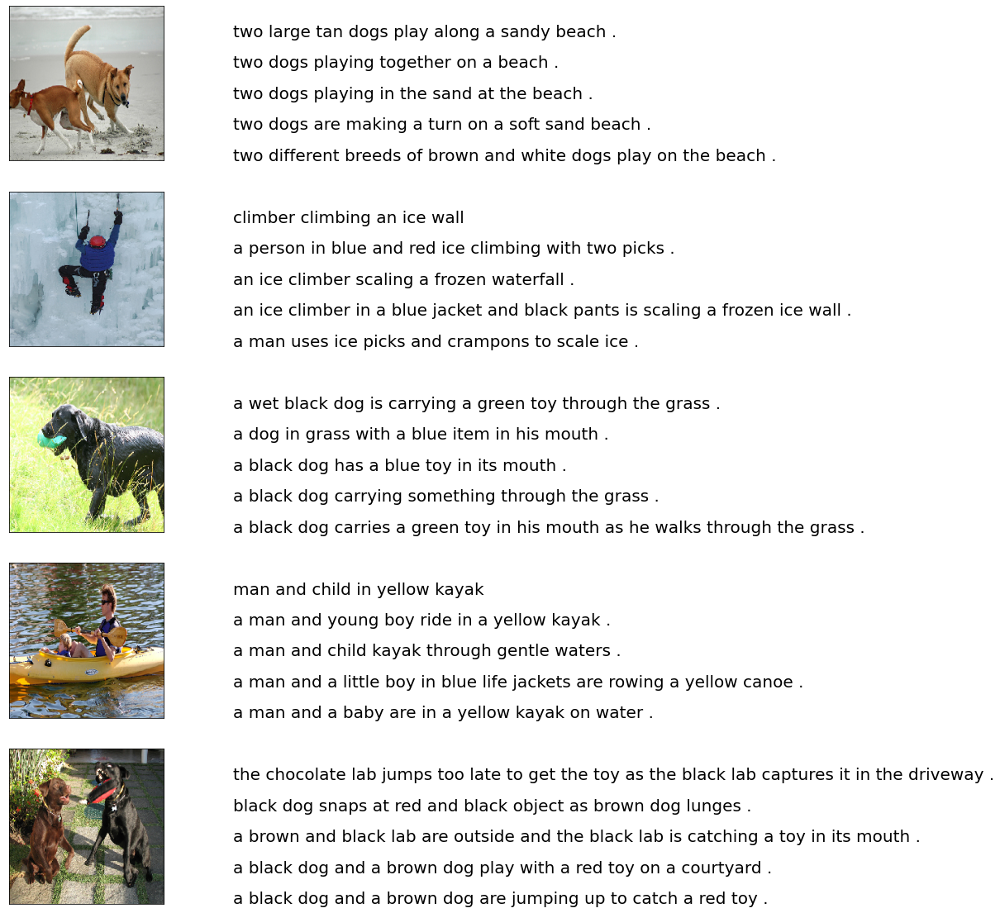

In [ ]:
image_desc_plotter(data)

# Data preprocessing

In [ ]:
def create_vocabulary(data):
  vocab = []
  for captions in data.caption.values:
    vocab.extend(captions.split())
  print("Vocabulary Size : {}".format(len(set(vocab))))
  return vocab

In [ ]:
vocabulary = create_vocabulary(data)

Vocabulary Size : 8918


In [ ]:
def df_word_count(data,vocabulary):
    ct = Counter(vocabulary)
    appen_1 = []
    appen_2 = []
    for i in ct.keys():
        appen_1.append(i)
    for j in ct.values():
        appen_2.append(j)
    data = {"word":appen_1 , "count":appen_2}
    dfword = pd.DataFrame(data)
    dfword = dfword.sort_values(by='count', ascending=False)
    dfword = dfword.reset_index()[["word","count"]]
    return(dfword)

In [ ]:
dfwordcount = df_word_count(data,vocabulary)

In [ ]:
dfwordcount.iloc[:10,:]

,word,count
0,a,62986
1,.,36577
2,in,18974
3,the,18418
4,on,10743
5,is,9345
6,and,8851
7,dog,8136
8,with,7765
9,man,7265


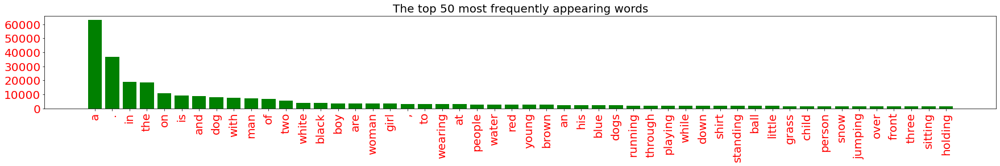

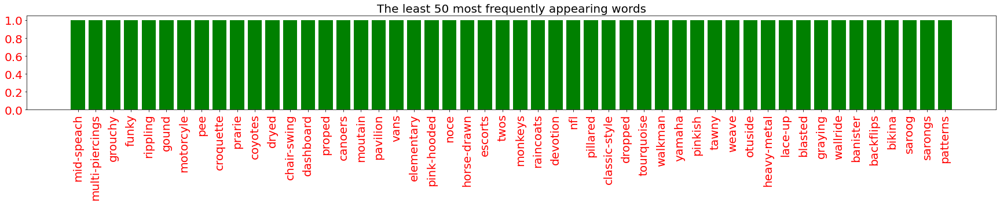

In [ ]:

topn = 50

def plthist(dfsub, title="The top 50 most frequently appearing words"):
    plt.figure(figsize=(30,3))
    plt.bar(dfsub.index,dfsub["count"],color ='g')
    plt.yticks(fontsize=20,color ='r')
    plt.xticks(dfsub.index,dfsub["word"],rotation=90,fontsize=20,color ='r')
    plt.title(title,fontsize=20)
    plt.show()

plthist(dfwordcount.iloc[:topn,:],
        title="The top 50 most frequently appearing words")
plthist(dfwordcount.iloc[-topn:,:],
        title="The least 50 most frequently appearing words")

In [ ]:
# The most common words are articles such as "a", or "the", or punctuations.

def text_clean(text_original):
    text = remove_punctuation(text_original)
    text = remove_single_character(text)
    text = remove_numeric(text)
    return(text)
    
for i, caption in enumerate(data.caption.values):
    newcaption = text_clean(caption)
    data["caption"].iloc[i] = newcaption

In [ ]:
clean_vocabulary = create_vocabulary(data) # reduced from 8918 to 8357 vocab size

Vocabulary Size : 8357


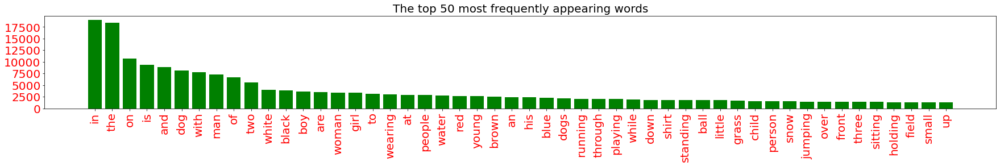

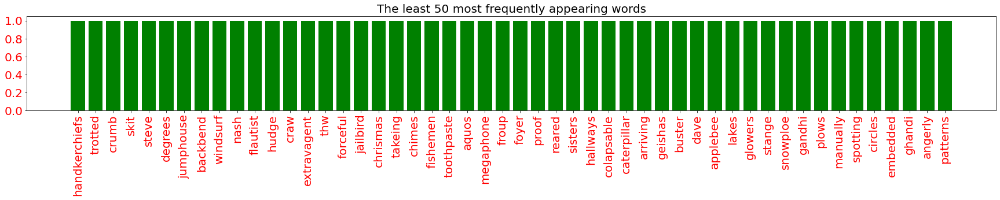

In [ ]:
dfwordcount = df_word_count(data,clean_vocabulary)
plthist(dfwordcount.iloc[:topn,:],
        title="The top 50 most frequently appearing words")
plthist(dfwordcount.iloc[-topn:,:],
        title="The least 50 most frequently appearing words")

In [ ]:
# Setting the path to load the images
def preprocess_images(data):
  all_img_name_vector = []

  for filenames in data["filename"]:
      full_image_path = image_dir+"/"+ filenames
      all_img_name_vector.append(full_image_path)
  return all_img_name_vector
  
all_img_name_vector = preprocess_images(data)
all_img_name_vector[:10]

['Flickr8k_Dataset/1000268201_693b08cb0e.jpg',
 'Flickr8k_Dataset/1000268201_693b08cb0e.jpg',
 'Flickr8k_Dataset/1000268201_693b08cb0e.jpg',
 'Flickr8k_Dataset/1000268201_693b08cb0e.jpg',
 'Flickr8k_Dataset/1000268201_693b08cb0e.jpg',
 'Flickr8k_Dataset/1001773457_577c3a7d70.jpg',
 'Flickr8k_Dataset/1001773457_577c3a7d70.jpg',
 'Flickr8k_Dataset/1001773457_577c3a7d70.jpg',
 'Flickr8k_Dataset/1001773457_577c3a7d70.jpg',
 'Flickr8k_Dataset/1001773457_577c3a7d70.jpg']

In [ ]:
# adding <start> and <end> tags to every caption, so that our model understands the starting and ending of each caption.
def preprocess_captions(data):
  total_captions = []

  for caption  in data["caption"].astype(str):
      caption = '<start> ' + caption+ ' <end>'
      total_captions.append(caption)
  return total_captions
  
total_captions = preprocess_captions(data)
total_captions[:10]

['<start>  child in pink dress is climbing up set of stairs in an entry way <end>',
 '<start>  girl going into wooden building <end>',
 '<start>  little girl climbing into wooden playhouse <end>',
 '<start>  little girl climbing the stairs to her playhouse <end>',
 '<start>  little girl in pink dress going into wooden cabin <end>',
 '<start>  black dog and spotted dog are fighting <end>',
 '<start>  black dog and dog playing with each other on the road <end>',
 '<start>  black dog and white dog with brown spots are staring at each other in the street <end>',
 '<start>  two dogs of different breeds looking at each other on the road <end>',
 '<start>  two dogs on pavement moving toward each other <end>']

In [ ]:
print("Total Images : " + str(len(all_img_name_vector)))
print("Total Captions : " + str(len(total_captions)))

Total Images : 40455
Total Captions : 40455


In [ ]:
#Taking only 40,000 images and captions, So that we can select batch size properly i.e. 625 batches if batch_size=64

def data_limiter(num,total_captions,all_img_name_vector):
  # Shuffle captions and image_names together
  train_captions, img_name_vector = shuffle(total_captions,all_img_name_vector,random_state=1)
  train_captions = train_captions[:num]
  img_name_vector = img_name_vector[:num]
  return train_captions,img_name_vector

In [ ]:
train_captions,img_name_vector = data_limiter(40000,total_captions,all_img_name_vector)

In [ ]:
print("Total Captions = {0} , Total images = {1}".format(len(train_captions),len(img_name_vector)))

Total Captions = 40000 , Total images = 40000


In [ ]:
from pickle import dump

# save to file
dump(train_captions, open('captions.pkl', 'wb'))
dump(img_name_vector, open('img_names.pkl', 'wb'))

In [ ]:
train_captions = load(open('captions.pkl', 'rb'))
img_name_vector = load(open('img_names.pkl', 'rb'))

In [ ]:
print("Total Captions = {0} , Total images = {1}".format(len(train_captions),len(img_name_vector)))

Total Captions = 40000 , Total images = 40000


In [ ]:
# To know the shape of images
def img_shape_finder(image):
  img= plt.imread(image)

  print("Shape of the image ==> {0} is ==> {1}".format(image.split('/')[1],img.shape))

In [ ]:
img_list=[]
for i in range(10):
  img_list.append(img_name_vector[i])

for j in img_list:
  img_shape_finder(j)

Shape of the image ==> 1956678973_223cb1b847.jpg is ==> (500, 375, 3)
Shape of the image ==> 3256603992_67312b5a36.jpg is ==> (375, 500, 3)
Shape of the image ==> 2938747424_64e64784f0.jpg is ==> (375, 500, 3)
Shape of the image ==> 2831314869_5025300133.jpg is ==> (400, 500, 3)
Shape of the image ==> 516725192_c9cdd63878.jpg is ==> (274, 500, 3)
Shape of the image ==> 537559285_29be110134.jpg is ==> (375, 500, 3)
Shape of the image ==> 2172493537_128bc8b187.jpg is ==> (334, 500, 3)
Shape of the image ==> 2287023569_fd7a9c60b8.jpg is ==> (500, 354, 3)
Shape of the image ==> 3191805046_77c334b506.jpg is ==> (500, 333, 3)
Shape of the image ==> 2869491449_1041485a6b.jpg is ==> (350, 500, 3)


# Pre-Trained Image Model (VGG16)


```
The VGG16 model was pre-trained on the ImageNet data-set for classifying images. 
The VGG16 model contains a convolutional part and a fully-connected (or dense) 
part which is used for the image classification.

It produces a vector of 4096 features for each image.
```


In [ ]:
import tensorflow as tf
modelvgg = tf.keras.applications.VGG16(include_top=True,weights=None) # for observation on shapes

In [ ]:
modelvgg.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [ ]:
# droping last layer(softmax)
image_model = tf.keras.applications.VGG16(include_top=False,weights='imagenet')
new_input = image_model.input # Any arbitrary shapes with 3 channels
hidden_layer = image_model.layers[-1].output

image_features_extract_model = tf.keras.Model(new_input, hidden_layer)

58900480/58889256 [==============================] - 1s 0us/step


In [ ]:
image_features_extract_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, None, None, 128)   0     

## Extract Features from VGG16

In [ ]:
# reshape image (224,224,3)
def load_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, (224, 224))
    img = preprocess_input(img)
    return img, image_path

In [ ]:

# Get unique images
encode_train = sorted(set(img_name_vector))
image_dataset = tf.data.Dataset.from_tensor_slices(encode_train)

# Map each image name to the function to load the image
image_dataset = image_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(64)


In [ ]:
image_dataset # images of shape (224,224,3)

<BatchDataset shapes: ((None, 224, 224, 3), (None,)), types: (tf.float32, tf.string)>

In [ ]:
# NPY files store all the information required to reconstruct an array on any computer, which includes dtype and shape information.
# store the features in .npy files

from tqdm import tqdm

for img, path in tqdm(image_dataset):
 batch_features = image_features_extract_model(img)
 batch_features = tf.reshape(batch_features,
                             (batch_features.shape[0], -1, batch_features.shape[3]))

 for bf, p in zip(batch_features, path):
   path_of_feature = p.numpy().decode("utf-8")
   np.save(path_of_feature, bf.numpy())

100%|██████████| 127/127 [31:22<00:00, 14.82s/it]


In [ ]:
np_img = np.load('Flickr8k_Dataset/3338291921_fe7ae0c8f8.jpg.npy')
print(np_img)
print("Shape : {}".format(np_img.shape))

[[0.        0.        0.        ... 0.        0.        0.       ]
 [0.        0.        0.        ... 0.        0.        0.       ]
 [0.        0.        0.        ... 0.        0.        0.       ]
 ...
 [0.        0.        0.        ... 0.        0.        0.       ]
 [0.        0.        0.        ... 0.        3.9950507 0.       ]
 [0.        0.        0.        ... 0.        0.        0.       ]]
Shape : (49, 512)


# Tokenizing the captions and creating vocabulary


*   Limit the vocabulary size to the top `5000` words to save memory.
*   Create a `word->index` mapping.
*   replace words not in vocabulary with the token `<unk>`.




In [ ]:
def tokenize_caption(top_k,train_captions):
  # Choose the top 5000 words from the vocabulary
  tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k,oov_token="<unk>",filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')
  # oov_token: if given, it will be added to word_index and used to replace out-of-vocabulary words during text_to_sequence calls
  
  tokenizer.fit_on_texts(train_captions)
  train_seqs = tokenizer.texts_to_sequences(train_captions)

  # Map '<pad>' to '0'
  tokenizer.word_index['<pad>'] = 0
  tokenizer.index_word[0] = '<pad>'


  # Create the tokenized vectors
  train_seqs = tokenizer.texts_to_sequences(train_captions)
  return train_seqs, tokenizer

train_seqs , tokenizer = tokenize_caption(5000,train_captions)

In [ ]:
train_captions[:3]

['<start>  several children leaping into pile of leaves on the ground <end>',
 '<start>  man hiking in the wilderness giving the camera thumbs up <end>',
 '<start>  white dog is running through the water onto the shore <end>']

In [ ]:
train_seqs[:3] # Here we can see that the sentences are converted to sequences

[[2, 184, 62, 331, 64, 524, 12, 329, 6, 5, 167, 3],
 [2, 11, 588, 4, 5, 2384, 895, 5, 93, 1281, 53, 3],
 [2, 14, 9, 7, 32, 33, 5, 24, 238, 5, 280, 3]]

In [ ]:
# Find the maximum length of any caption in our dataset
def calc_max_length(tensor):
    return max(len(t) for t in tensor)
    
# Calculates the max_length, which is used to store the attention weights
max_length = calc_max_length(train_seqs)

In [ ]:
# Find the maximum length of any caption in our dataset
def calc_min_length(tensor):
    return min(len(t) for t in tensor)
    
# Calculates the max_length, which is used to store the attention weights
min_length = calc_min_length(train_seqs)

In [ ]:
print('Max Length of any caption : Min Length of any caption = '+ str(max_length) +" : "+str(min_length))

Max Length of any caption : Min Length of any caption = 33 : 2


## Padding each vector

In [ ]:
# Pad each vector to the max_length of the captions, so that all caption vectors are of same length

def padding_train_sequences(train_seqs,max_length,padding_type):
  cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding=padding_type,maxlen=max_length)
  return cap_vector


In [ ]:
padded_caption_vector = padding_train_sequences(train_seqs,max_length,'post')
print(padded_caption_vector.shape)

(40000, 33)


In [ ]:
padded_caption_vector

array([[  2, 184,  62, ...,   0,   0,   0],
       [  2,  11, 588, ...,   0,   0,   0],
       [  2,  14,   9, ...,   0,   0,   0],
       ...,
       [  2,  19,   4, ...,   0,   0,   0],
       [  2,  16,   4, ...,   0,   0,   0],
       [  2, 153,   9, ...,   0,   0,   0]], dtype=int32)

# Train-Test Split

In [ ]:
# Create training and test set using an 80-20 split
img_name_train, img_name_test, caption_train, caption_test = train_test_split(img_name_vector,padded_caption_vector,
                                                                              test_size=0.2,random_state=0)

In [ ]:
print("Training Data : X = {0},Y = {1}".format(len(img_name_train), len(caption_train)))
print("Test Data : X = {0},Y = {1}".format(len(img_name_test), len(caption_test)))

Training Data : X = 32000,Y = 32000
Test Data : X = 8000,Y = 8000


## Parameters

In [ ]:
# Define the parameters for training:
BATCH_SIZE = 64
BUFFER_SIZE = 1000
embedding_dim = 256
units = 512
vocab_size = len(tokenizer.word_index) + 1 #5000
num_steps = len(img_name_train) // BATCH_SIZE #500
# Shape from last layer of VGG-16 :(7,7,512)
# So, say there are 49 pixel locations now and each pixel is 512 dimensional
features_shape = 512
attention_features_shape = 49


## Creating dataset
 create a **tf.data dataset** to use for training our model i.e, one batch at a time  during training.



In [ ]:
# Loading the .npy files
def load_npy(img_name, cap):
  img_tensor = np.load(img_name.decode('utf-8')+'.npy')
  return img_tensor, cap

In [ ]:
'''
# How Dataset.from_tensor_slices work
t = tf.constant([[1, 2], [3, 4]])
ds = tf.data.Dataset.from_tensor_slices(t)   # [1, 2], [3, 4]
ds # <TensorSliceDataset shapes: (2,), types: tf.int32>
'''
def create_dataset(img_name_train,caption_train):

  
  dataset = tf.data.Dataset.from_tensor_slices((img_name_train, caption_train))

  # Use map to load the numpy files in parallel
  dataset = dataset.map(lambda item1, item2: tf.numpy_function(load_npy, [item1, item2], [tf.float32, tf.int32]),num_parallel_calls=tf.data.experimental.AUTOTUNE)

  # Shuffle and batch
  dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE).prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
  return dataset


In [ ]:
# Creating train and test dataset
dataset = create_dataset(img_name_train,caption_train)
test_dataset = create_dataset(img_name_test,caption_test)

# Define the encoder-decoder architecture with attention.


```
CNN Encoder -> Attention Layer -> RNN Decoder
```



In [ ]:
# VGG-16 Encoder is defined as single fully connected layer followed by ReLU activation.
class VGG16_Encoder(tf.keras.Model):
    # This encoder passes the features through a Fully connected layer
    def __init__(self, embedding_dim):
        super(VGG16_Encoder, self).__init__()
        # shape after fc == (batch_size, 49, embedding_dim)
        self.fc = tf.keras.layers.Dense(embedding_dim)
        self.dropout = tf.keras.layers.Dropout(0.5, noise_shape=None, seed=None)

    def call(self, x):
        #x= self.dropout(x)
        x = self.fc(x)
        x = tf.nn.relu(x)
        return x        

In [ ]:
# RNN based on GPU/CPU capabilities-
def rnn_type(units):
    if tf.test.is_gpu_available():
        return tf.compat.v1.keras.layers.CuDNNLSTM(units, 
                                        return_sequences=True, 
                                        return_state=True, 
                                        recurrent_initializer='glorot_uniform')
    else:
        return tf.keras.layers.GRU(units, 
                                   return_sequences=True, 
                                   return_state=True, 
                                   recurrent_activation='sigmoid', 
                                   recurrent_initializer='glorot_uniform')

In [ ]:
# RNN Decoder with Bahdanau Attention (LOCAL): This Attention Mechanism will return the context vector and attention weights over the time axis.

'''The encoder output(i.e. 'features'), hidden state(initialized to 0)(i.e. 'hidden') and
the decoder input (which is the start token)(i.e. 'x') is passed to the decoder.'''

class Rnn_Local_Decoder(tf.keras.Model):
  def __init__(self, embedding_dim, units, vocab_size):
    super(Rnn_Local_Decoder, self).__init__()
    self.units = units

    self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
    self.gru = tf.keras.layers.GRU(self.units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    
    self.fc1 = tf.keras.layers.Dense(self.units)

    self.dropout = tf.keras.layers.Dropout(0.5, noise_shape=None, seed=None)
    self.batchnormalization = tf.keras.layers.BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001, center=True, scale=True, beta_initializer='zeros', gamma_initializer='ones', moving_mean_initializer='zeros', moving_variance_initializer='ones', beta_regularizer=None, gamma_regularizer=None, beta_constraint=None, gamma_constraint=None)

    self.fc2 = tf.keras.layers.Dense(vocab_size)

    # Implementing Attention Mechanism 
    self.Uattn = tf.keras.layers.Dense(units)
    self.Wattn = tf.keras.layers.Dense(units)
    self.Vattn = tf.keras.layers.Dense(1)
    


  def call(self, x, features, hidden):
    
    # features shape ==> (64,49,256) ==> Output from ENCODER
    
    # hidden shape == (batch_size, hidden_size) ==>(64,512)
    # hidden_with_time_axis shape == (batch_size, 1, hidden_size) ==> (64,1,512)
    
    hidden_with_time_axis = tf.expand_dims(hidden, 1)
    
    # score shape == (64, 49, 1)
    # Attention Function
    '''e(ij) = f(s(t-1),h(j))'''
    ''' e(ij) = Vattn(T)*tanh(Uattn * h(j) + Wattn * s(t))'''
    score = self.Vattn(tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis)))
    # self.Uattn(features) : (64,49,512)
    # self.Wattn(hidden_with_time_axis) : (64,1,512)
    # tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis)) : (64,49,512)
    # self.Vattn(tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis))) : (64,49,1) ==> score
    # you get 1 at the last axis because you are applying score to self.Vattn
    
    
    # Then find Probability using Softmax
    '''attention_weights(alpha(ij)) = softmax(e(ij))'''
    attention_weights = tf.nn.softmax(score, axis=1)
    # attention_weights shape == (64, 49, 1)

    
    # Give weights to the different pixels in the image
    ''' C(t) = Summation(j=1 to T) (attention_weights * VGG-16 features) ''' 
    context_vector = attention_weights * features
    context_vector = tf.reduce_sum(context_vector, axis=1)
    # Context Vector(64,256) = AttentionWeights(64,49,1) * features(64,49,256)
    # context_vector shape after sum == (64, 256)
    
    
    # x shape after passing through embedding == (64, 1, 256)
    x = self.embedding(x)
    
    # x shape after concatenation == (64, 1,  512)
    x = tf.concat([tf.expand_dims(context_vector, 1), x], axis=-1)

    # passing the concatenated vector to the GRU
    output, state = self.gru(x)

    # shape == (batch_size, max_length, hidden_size)
    x = self.fc1(output)

    # x shape == (batch_size * max_length, hidden_size)
    x = tf.reshape(x, (-1, x.shape[2]))

    # Adding Dropout and BatchNorm Layers
    x= self.dropout(x)
    x= self.batchnormalization(x)
    # output shape == (64 * 512)
    x = self.fc2(x)
    # shape : (64 * 8329(vocab))
    return x, state, attention_weights

  def reset_state(self, batch_size):
    return tf.zeros((batch_size, self.units))

In [ ]:
encoder = VGG16_Encoder(embedding_dim)
decoder = Rnn_Local_Decoder(embedding_dim, units, vocab_size)

In [ ]:
# Define the loss function and optimizers:
optimizer = tf.keras.optimizers.Adam()
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
    from_logits=True, reduction='none')

def loss_function(real, pred):
  mask = tf.math.logical_not(tf.math.equal(real, 0))
  loss_ = loss_object(real, pred)

  mask = tf.cast(mask, dtype=loss_.dtype)
  loss_ *= mask

  return tf.reduce_mean(loss_)

## Saving Checkpoint
* TensorFlow objects provide an easy automatic mechanism for saving and restoring the values of variables they use.
* All prefixes are grouped together in a single checkpoint file ('./tf_ckpts/checkpoint') where the CheckpointManager saves its state.

In [ ]:
checkpoint_path_ckpt = "./checkpoint_finally19/train"
ckpt = tf.train.Checkpoint(encoder=encoder,
                           decoder=decoder,
                           optimizer = optimizer)
ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path_ckpt, max_to_keep=5)

In [ ]:
#Start checkpointing from the checkpoint last saved
start_epoch = 0
if ckpt_manager.latest_checkpoint:
  start_epoch = int(ckpt_manager.latest_checkpoint.split('-')[-1])

## Setup Tensorboard summary writer

In [ ]:
# Clear previous logs
!rm -rf ./logs/ 

In [ ]:
# Define our metrics
train_loss = tf.keras.metrics.Mean('train_loss', dtype=tf.float32)
# train_accuracy = tf.keras.metrics.SparseCategoricalAccuracy('train_accuracy')

In [ ]:
import datetime
current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
train_log_dir = 'logs/gradient_tape/' + current_time + '/train'
test_log_dir = 'logs/gradient_tape/' + current_time + '/test'
train_summary_writer = tf.summary.create_file_writer(train_log_dir)
test_summary_writer = tf.summary.create_file_writer(test_log_dir)

# Model training


### Training Steps:
- The ENCODER output, hidden state(initialised to 0) and the DECODER input(which is the < start > token) are passed to the DECODER.

- The DECODER returns the predictions and the DECODER hidden state.

- The DECODER hidden state is then passed back into the model and the predictions are used to calculate the loss. While training, we use the Teacher Forcing technique, to decide the next input of the DECODER.

- __Teacher Forcing is the technique where the target word is passed as the next input to the DECODER. This technique helps to learn the correct sequence or correct statistical properties fro the sequence, quickly.__

- Final step is to calculate the Gradient and apply it to the optimizer and backpropagate 

In [ ]:
loss_plot = []

@tf.function
def train_step(img_tensor, target):
  loss = 0

  # initializing the hidden state for each batch
  # because the captions are not related from image to image
  hidden = decoder.reset_state(batch_size=target.shape[0])

  dec_input = tf.expand_dims([tokenizer.word_index['<start>']] * BATCH_SIZE, 1)

  with tf.GradientTape() as tape:
      features = encoder(img_tensor)

      for i in range(1, target.shape[1]):
          # passing the features through the decoder
          #dec_input = tf.expand_dims(target[:, i], 1)
          predictions, hidden, _ = decoder(dec_input, features, hidden)

          loss += loss_function(target[:, i], predictions)

          # using teacher forcing
          dec_input = tf.expand_dims(target[:, i], 1)
          

  total_loss = (loss / int(target.shape[1]))

  trainable_variables = encoder.trainable_variables + decoder.trainable_variables

  gradients = tape.gradient(loss, trainable_variables)

  optimizer.apply_gradients(zip(gradients, trainable_variables))

  #train_loss(loss)
  #train_accuracy(target, predictions)

  return loss, total_loss

### Testing Steps
- It is similar to training step, just that we do not update the gradients, and provide the predicted output as decoder input to next RNN cell at next time steps.
- Test step is required to find out whether the model built is overfitting or not.

In [ ]:
test_loss_plot = []

@tf.function
def test_step(img_tensor, target):
  loss = 0

  # initializing the hidden state for each batch
  # because the captions are not related from image to image
  hidden = decoder.reset_state(batch_size=target.shape[0])

  dec_input = tf.expand_dims([tokenizer.word_index['<start>']] * BATCH_SIZE, 1)

  features = encoder(img_tensor)

  for i in range(1, target.shape[1]):
      # passing the features through the decoder

      
      predictions, hidden, attention_weights = decoder(dec_input, features, hidden)
      # predictions : (64,8329)
      loss += loss_function(target[:, i], predictions)
      
      predicted_id = tf.argmax(predictions[0])
      dec_input = tf.expand_dims([predicted_id]*BATCH_SIZE, 1)
 

  total_loss = (loss / int(target.shape[1]))

  return loss, total_loss

### Train the model

In [ ]:
for epoch in range(start_epoch, 20):
    start = time.time()

    #For Train
    #================================================================
    total_loss_train = 0
    for (batch, (img_tensor, target)) in enumerate(dataset):
        batch_loss, t_loss = train_step(img_tensor, target)
        total_loss_train += t_loss
    # storing the epoch end loss value to plot later
    loss_plot.append(total_loss_train / num_steps)

    # Tensorboard 
    with train_summary_writer.as_default():
      tf.summary.scalar('LossPlotTrain', (total_loss_train/ num_steps), step=epoch)
      tf.summary.scalar('Train_loss', train_loss.result(), step=epoch)

    #For Test
    #================================================================
    total_loss_test = 0
    for (batch, (img_tensor, target)) in enumerate(test_dataset):
        batch_loss, t_loss = test_step(img_tensor, target)
        total_loss_test += t_loss
    # storing the epoch end loss value to plot later
    test_loss_plot.append(total_loss_test / num_steps) 

    # Tensorboard 
    with test_summary_writer.as_default():
      tf.summary.scalar('LossPlotTest', (total_loss_test/ num_steps), step=epoch)

    
    if epoch % 5 == 0:
      ckpt_manager.save()

    print ('Epoch {} TrainLoss {:.6f} TestLoss {:.6f}'.format(epoch + 1,(total_loss_train/num_steps),(total_loss_test/num_steps)))
    print ('Time taken for 1 epoch {} sec\n'.format(time.time() - start))

Epoch 1 TrainLoss 1.459412 TestLoss 0.489440
Time taken for 1 epoch 3420.8349027633667 sec

Epoch 2 TrainLoss 1.119808 TestLoss 0.492019
Time taken for 1 epoch 183.0814847946167 sec

Epoch 3 TrainLoss 1.000187 TestLoss 0.499884
Time taken for 1 epoch 183.20399832725525 sec

Epoch 4 TrainLoss 0.917261 TestLoss 0.503142
Time taken for 1 epoch 183.5964753627777 sec

Epoch 5 TrainLoss 0.849196 TestLoss 0.508221
Time taken for 1 epoch 182.57454419136047 sec

Epoch 6 TrainLoss 0.797510 TestLoss 0.508042
Time taken for 1 epoch 183.6446168422699 sec

Epoch 7 TrainLoss 0.743027 TestLoss 0.529036
Time taken for 1 epoch 224.09749245643616 sec

Epoch 8 TrainLoss 0.698242 TestLoss 0.545339
Time taken for 1 epoch 183.26651906967163 sec

Epoch 9 TrainLoss 0.657068 TestLoss 0.553529
Time taken for 1 epoch 183.35465908050537 sec

Epoch 10 TrainLoss 0.621932 TestLoss 0.576163
Time taken for 1 epoch 183.2381772994995 sec

Epoch 11 TrainLoss 0.589412 TestLoss 0.574265
Time taken for 1 epoch 183.1511602401

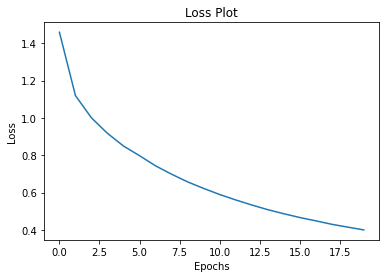

In [ ]:
plt.plot(loss_plot)
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss Plot')
plt.show()

# Launching Tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs/gradient_tape

<IPython.core.display.Javascript object>

In [ ]:
ckpt_manager.checkpoints

['./checkpoint_finally19/train/ckpt-1',
 './checkpoint_finally19/train/ckpt-2',
 './checkpoint_finally19/train/ckpt-3',
 './checkpoint_finally19/train/ckpt-4']

In [ ]:
ckpt.restore('./checkpoint_finally19/train/ckpt-4')

## Plotting the loss graph

In [ ]:
# loss_plot=[1.459412,1.119808,1.000187,0.917261,0.849196,0.797510,0.743027,0.698242,0.657068,0.621932,0.589412,0.560196,0.533186,0.508094,0.486276,0.465909,0.448162,0.429508, 0.414393, 0.399355]
# test_loss_plot=[0.489440,0.492019,0.499884,0.503142,0.508221,0.508042,0.529036,0.545339,0.553529,0.576163,0.574265,0.595111,0.626507,0.640342,0.649162,0.670810,0.690037,0.698673,0.720272,0.738827]

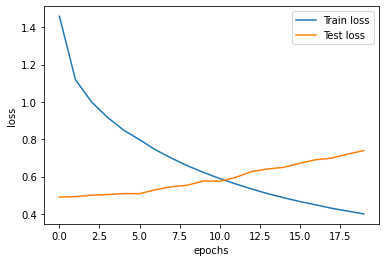

In [ ]:
for label in [loss_plot,test_loss_plot]:
    plt.plot(label)
plt.legend(["Train loss", "Test loss"])
plt.xlabel("epochs")
plt.ylabel("loss")
plt.show()


# Evaluate the Captions:
- The evaluate function is similar to the training loop, except we don't use Teacher Forcing here. 
- The input to Decoder at each time step is its previous predictions, along with the hidden state and the ENCODER output.

**Methods** -
1. Greedy Approach 
2. Beam Search

### Greedy Approach
- This is called as `Maximum Likelihood Estimation (MLE)` i.e. we select that word which is most likely according to the model for the given input.
- we greedily select the **word with maximum probability**.

In [ ]:
def evaluate(image):
    attention_plot = np.zeros((max_length, attention_features_shape)) # 33, 49 (7*7)

    hidden = decoder.reset_state(batch_size=1)

    temp_input = tf.expand_dims(load_image(image)[0], 0) 
    img_tensor_val = image_features_extract_model(temp_input)
    img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3])) #resizing (224,224,3)

    features = encoder(img_tensor_val)

    dec_input = tf.expand_dims([tokenizer.word_index['<start>']], 0) # Start token is <start> for LSTM
    result = []

    for i in range(max_length):
        predictions, hidden, attention_weights = decoder(dec_input, features, hidden)

        attention_plot[i] = tf.reshape(attention_weights, (-1, )).numpy()

        predicted_id = tf.argmax(predictions[0]).numpy()
        result.append(tokenizer.index_word[predicted_id]) # Store the result or word predicted

        if tokenizer.index_word[predicted_id] == '<end>': # if you reach <end> token then return the result
            return result, attention_plot

        dec_input = tf.expand_dims([predicted_id], 0) # Decoder input is the word predicted at previous timestep

    attention_plot = attention_plot[:len(result), :]
    return result, attention_plot

## Visual Attention

In [ ]:
#  function to visualise the attention points that predicts the words.
def plot_attention(image, result, attention_plot):
    temp_image = np.array(Image.open(image))

    fig = plt.figure(figsize=(10, 10))
    len_result = len(result)
    for l in range(len_result):
        temp_att = np.resize(attention_plot[l], (8, 8))
        ax = fig.add_subplot(len_result//2, len_result//2, l+1)
        ax.set_title(result[l])
        img = ax.imshow(temp_image)
        ax.imshow(temp_att, cmap='gray', alpha=0.6, extent=img.get_extent())

    plt.tight_layout()
    plt.show()

### Beam Search
- Here we take `top k predictions`, feed them again in the model and then sort them using the probabilities returned by the model. So, the list will always contain the top k predictions. 
- In the end, we take the one with the highest probability and go through it till we encounter `<end>` or reach the maximum caption length.

In [ ]:
def beam_search(image, beam_index = 3):

    start = [tokenizer.word_index['<start>']]
    
    # result[0][0] = index of the starting word
    # result[0][1] = probability of the word predicted
    result = [[start, 0.0]]

    attention_plot = np.zeros((max_length, attention_features_shape)) # 33, 49

    hidden = decoder.reset_state(batch_size=1)

    temp_input = tf.expand_dims(load_image(image)[0], 0)
    img_tensor_val = image_features_extract_model(temp_input)
    img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))

    features = encoder(img_tensor_val)

    dec_input = tf.expand_dims([tokenizer.word_index['<start>']], 0)

    while len(result[0][0]) < max_length:
        i=0
        temp = []
        for s in result:

          predictions, hidden, attention_weights = decoder(dec_input, features, hidden)

          attention_plot[i] = tf.reshape(attention_weights, (-1, )).numpy()
          i=i+1
          # Getting the top <beam_index>(n) predictions
          word_preds = np.argsort(predictions[0])[-beam_index:]
          
          # creating a new list so as to put them via the model again
          for w in word_preds:       
            next_cap, prob = s[0][:], s[1]
            next_cap.append(w)
            prob += predictions[0][w]
            temp.append([next_cap, prob])

        result = temp
        # Sorting according to the probabilities
        result = sorted(result, reverse=False, key=lambda l: l[1])
        # Getting the top words
        result = result[-beam_index:]
        
        predicted_id = result[-1] # with Max Probability
        pred_list = predicted_id[0]
        
        prd_id = pred_list[-1] 
        if(prd_id!=3):  #
          dec_input = tf.expand_dims([prd_id], 0)  # Decoder input is the word predicted with highest probability among the top_k words predicted
        else:
          break

    result = result[-1][0]
    
    intermediate_caption = [tokenizer.index_word[i] for i in result]
    final_caption = []
    for i in intermediate_caption:
        if i != '<end>':
            final_caption.append(i)
            
        else:
            break

    attention_plot = attention_plot[:len(result), :]
    final_caption = ' '.join(final_caption[1:])
    return final_caption,attention_plot


# def beam_search_predictions(image, beam_index = 3):
#     start = [word2idx["<start>"]]
    
#     start_word = [[start, 0.0]]
    
#     while len(start_word[0][0]) < max_len:
#         temp = []
#         for s in start_word:
#             par_caps = sequence.pad_sequences([s[0]], maxlen=max_len, padding='post')
#             e = encoding_test[image[len(images):]]
#             preds = final_model.predict([np.array([e]), np.array(par_caps)])
            
#             word_preds = np.argsort(preds[0])[-beam_index:]
            
#             # Getting the top <beam_index>(n) predictions and creating a 
#             # new list so as to put them via the model again
#             for w in word_preds:
#                 next_cap, prob = s[0][:], s[1]
#                 next_cap.append(w)
#                 prob += preds[0][w]
#                 temp.append([next_cap, prob])
                    
#         start_word = temp
#         # Sorting according to the probabilities
#         start_word = sorted(start_word, reverse=False, key=lambda l: l[1])
#         # Getting the top words
#         start_word = start_word[-beam_index:]
    
#     start_word = start_word[-1][0]
#     intermediate_caption = [idx2word[i] for i in start_word]

#     final_caption = []
    
#     for i in intermediate_caption:
#         if i != '<end>':
#             final_caption.append(i)
#         else:
#             break
    
#     final_caption = ' '.join(final_caption[1:])
#     return final_caption

## BLEU Score
**Bilingual evaluation understudy**  compares the generated caption with
referenced caption and word to word matching takes place. On an average score is computed.

    Generated Text: This is for test
    Reference Text: This is only test (score 0.75 or 75%) 
    
-  Metric to evaluate the result of the the test set generated captions.
-  compare n-grams of the candidate with the n-grams of the reference translation and count the number of matches

In [ ]:
#Example
# n-gram individual BLEU
from nltk.translate.bleu_score import sentence_bleu
from nltk.translate.bleu_score import corpus_bleu

reference = [['this', 'a', 'test','of', 'cricket', 'match']]
candidate = ['this', 'is', 'a', 'test','of', 'cricket', 'match']
print("The cumulative and individual 1-gram BLEU use the same weights, e.g. (1, 0, 0, 0)")
print('Sentence Bleu 1-gram: %f' % sentence_bleu(reference, candidate, weights=(1, 0, 0, 0)))
print('Corpus Bleu 1-gram: %f' % corpus_bleu([reference], [candidate], weights=(1, 0, 0, 0)))
print("\n")

print("The cumulative and individual 2-gram BLEU use the same weights, e.g. (0, 1, 0, 0)")
print('Sentence Bleu 2-gram: %f' % sentence_bleu(reference, candidate, weights=(0, 1, 0, 0)))
print('Corpus Bleu 2-gram: %f' % corpus_bleu([reference], [candidate], weights=(0, 1, 0, 0)))
print("\n")

print("The cumulative and individual 3-gram BLEU use the same weights, e.g. (0, 0, 1, 0)")
print('Sentence Bleu 3-gram: %f' % sentence_bleu(reference, candidate, weights=(0, 0, 1, 0)))
print('Corpus Bleu 3-gram: %f' % corpus_bleu([reference], [candidate], weights=(0, 0, 1, 0)))
print("\n")

print("The cumulative and individual 4-gram BLEU use the same weights, e.g. (0, 0, 0, 1)")
print('Sentence Bleu 4-gram: %f' % sentence_bleu(reference, candidate, weights=(0, 0, 0, 1)))
print('Corpus Bleu 4-gram: %f' % corpus_bleu([reference], [candidate], weights=(0, 0, 0, 1)))
print("\n")

print("The 2-gram weights assign a 50% to each of 1-gram and 2-gram")
print('Corpus Bleu 1-gram: %f' % corpus_bleu([reference], [candidate], weights=(0.5, 0.5, 0, 0)))
print("\n")

print("3-gram weights are 33% for each of the 1, 2 and 3-gram scores")
print('Corpus Bleu 1-gram: %f' % corpus_bleu([reference], [candidate], weights=(0.33, 0.33, 0.33, 0)))
print("\n")

print("4-gram weights are 25% for each of the 1, 2 3 and 4-gram scores")
print('Corpus Bleu 1-gram: %f' % corpus_bleu([reference], [candidate], weights=(0.25, 0.25, 0.25, 0.25)))

The cumulative and individual 1-gram BLEU use the same weights, e.g. (1, 0, 0, 0)
Sentence Bleu 1-gram: 0.857143
Corpus Bleu 1-gram: 0.857143


The cumulative and individual 2-gram BLEU use the same weights, e.g. (0, 1, 0, 0)
Sentence Bleu 2-gram: 0.666667
Corpus Bleu 2-gram: 0.666667


The cumulative and individual 3-gram BLEU use the same weights, e.g. (0, 0, 1, 0)
Sentence Bleu 3-gram: 0.600000
Corpus Bleu 3-gram: 0.600000


The cumulative and individual 4-gram BLEU use the same weights, e.g. (0, 0, 0, 1)
Sentence Bleu 4-gram: 0.500000
Corpus Bleu 4-gram: 0.500000


The 2-gram weights assign a 50% to each of 1-gram and 2-gram
Corpus Bleu 1-gram: 0.755929


3-gram weights are 33% for each of the 1, 2 and 3-gram scores
Corpus Bleu 1-gram: 0.702405


4-gram weights are 25% for each of the 1, 2 3 and 4-gram scores
Corpus Bleu 1-gram: 0.643459


## Generate captions

In [ ]:
# captions on the validation set

from PIL import Image
from nltk.translate.bleu_score import sentence_bleu

Flickr8k_Dataset/3759230208_1c2a492b12.jpg
BELU score: 7.6104622520288014
Real Caption: boy is being splashed in the face whilst riding blue ring along yellow water slide
Prediction Caption: child slides down water slide


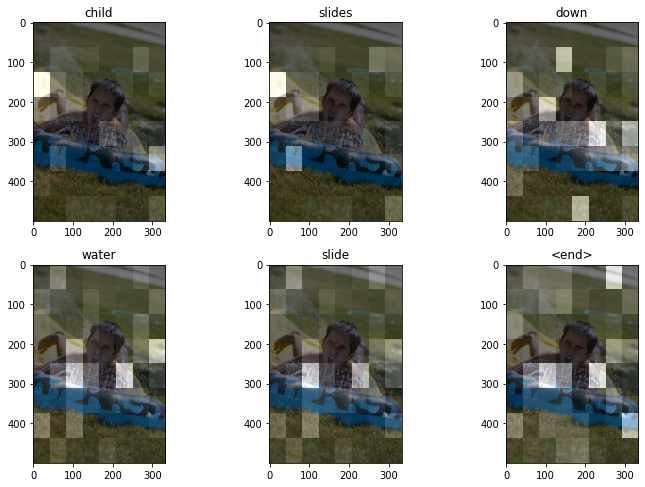

time took to Predict: 2 sec


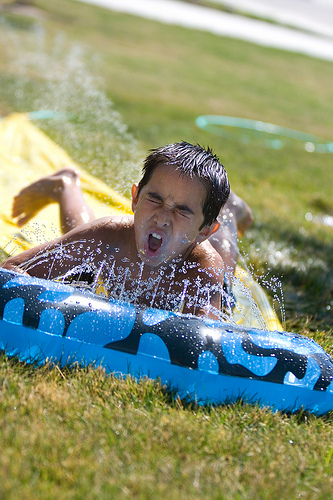

In [ ]:


rid = np.random.randint(0, len(img_name_test))
image = img_name_test[rid]
print(image)
start = time.time()
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate)#, weights=(0.5, 0.5, 0, 0))
print(f"BLEU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open(img_name_test[rid])

In [ ]:
def generate_captions(image, real_caption):
  print(image)
  start = time.time()
  result, attention_plot = evaluate(image)
  # result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
  # We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions
  first = real_caption.split(' ', 1)[1]
  real_caption = first.rsplit(' ', 1)[0]

  #remove "<unk>" in result
  for i in result:
      if i=="<unk>":
          result.remove(i)


  #remove <end> from result         
  result_join = ' '.join(result)
  result_final = result_join.rsplit(' ', 1)[0]

  real_appn = []
  real_appn.append(real_caption.split())
  reference = real_appn
  candidate = result_final.split()

  score = sentence_bleu(reference, candidate)#, weights=(0.5, 0.5, 0, 0))
  print(f"BLEU score: {score*100}")

  print ('Real Caption:', real_caption)
  print ('Prediction Caption:', result_final)

  plot_attention(image, result, attention_plot)

  print(f"time took to Predict: {round(time.time()-start)} sec")
  # opening the image
  Image.open(image)

Flickr8k_Dataset/2662816021_ac474e0fde.jpg
BELU score: 14.162677936694863
Real Caption: white dog holds stick in its mouth as it comes out of the water
Prediction Caption: dog retrieves stick in its mouth


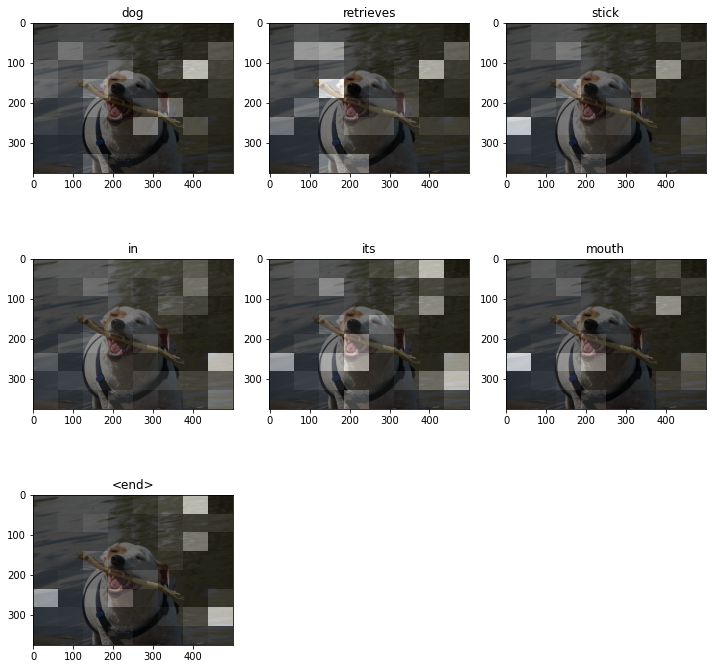

time took to Predict: 2 sec


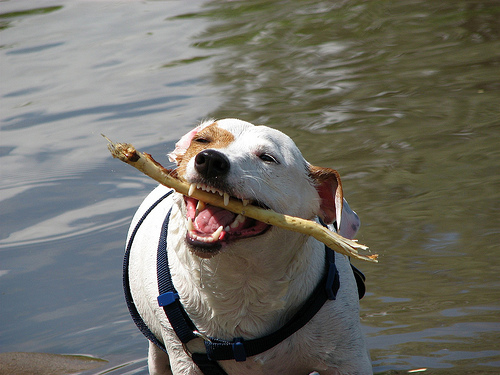

In [ ]:
# specific image
# image='Flickr8k_Dataset/505944126_f9a6ab8944.jpg'
# real_caption='<start> two dogs playing outside <end>'

#random images

rid = np.random.randint(0, len(img_name_test))
image = img_name_test[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
generate_captions(image, real_caption)
Image.open(image)

Flickr8k_Dataset/505944126_f9a6ab8944.jpg
BELU score: 0
Real Caption: two dogs playing outside
Prediction Caption: dog and black dog


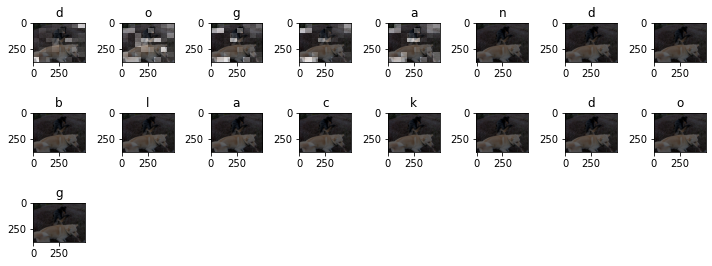

time took to Predict: 3 sec


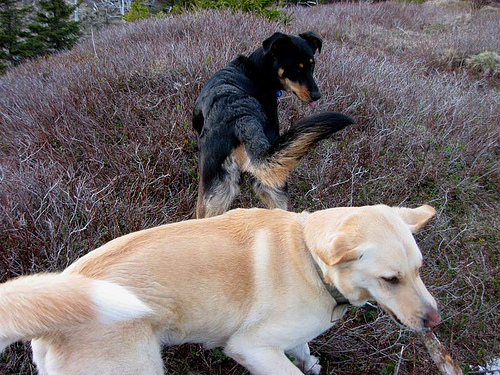

In [ ]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

# rid = np.random.randint(0, len(img_name_test))
# image = img_name_test[rid]
image= 'Flickr8k_Dataset/505944126_f9a6ab8944.jpg'
print(image)
start = time.time()
# real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
real_caption='<start> two dogs playing outside <end>'
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate)
print(f"BLEU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)

plot_attention(image, result_final, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open(image)

Flickr8k_Dataset/3113322995_13781860f2.jpg
BELU score: 70.71067811865476
Real Caption: <unk> team runs through snowy trail
Prediction Caption: pack of huskies run through the snowy track


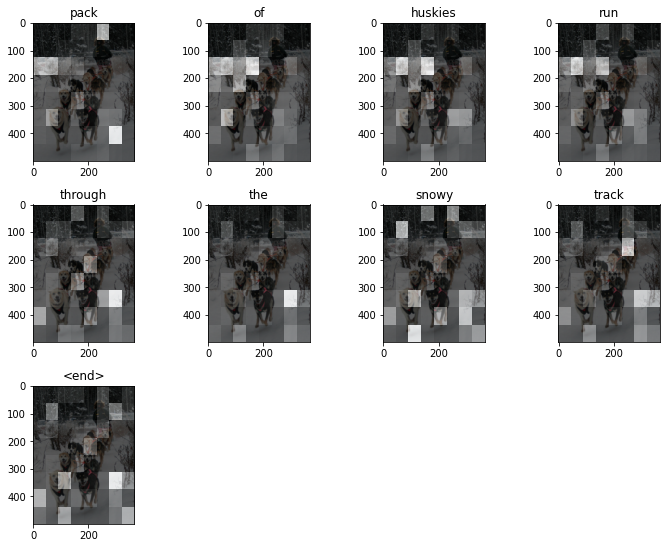

time took to Predict: 2 sec


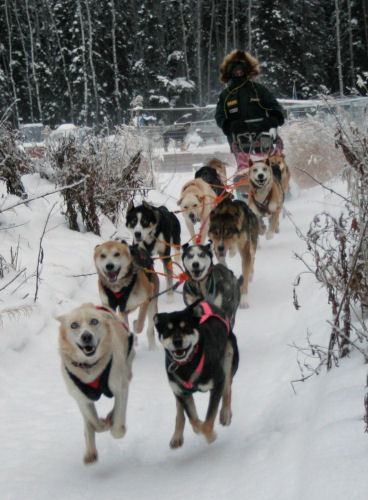

In [ ]:
# specific image
image='Flickr8k_Dataset/3113322995_13781860f2.jpg'
real_caption='<start> team runs through snowy trail <end>'

generate_captions(image,real_caption)
Image.open(image)

Flickr8k_Dataset/1454841725_4b6e6199e2.jpg
BELU score: 37.69486629893372
Real Caption: four young girls posing for the camera
Prediction Caption: four young girls are smiling


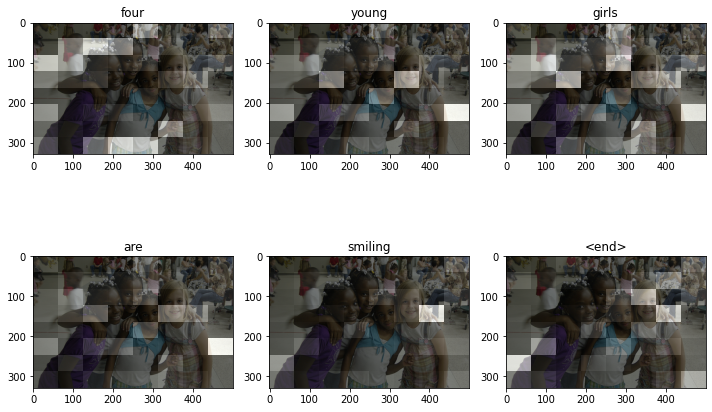

time took to Predict: 2 sec


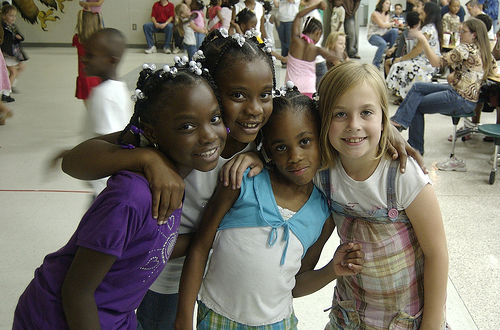

In [ ]:
#random images
#train_Set
rid = np.random.randint(0, len(img_name_train))
image = img_name_train[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_train[rid] if i not in [0]])
generate_captions(image, real_caption)
Image.open(image)

BELU score: 54.254864072519524
Real Caption: the brown dog is standing in dry grass field
Prediction Caption: brown dog is running through dry grass field


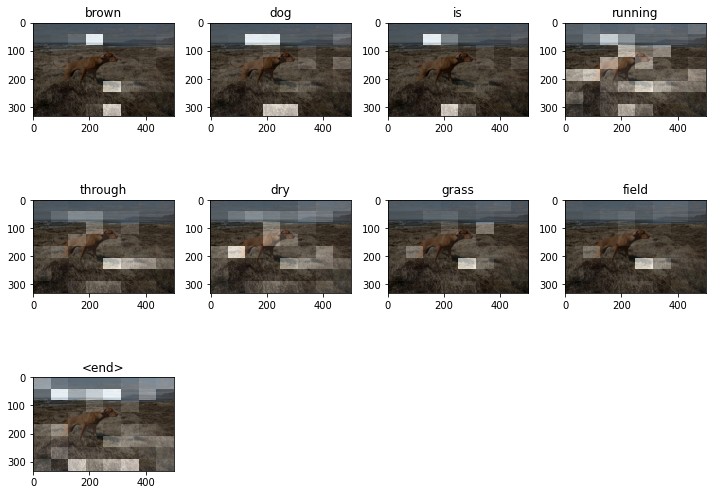

time took to Predict: 3 sec


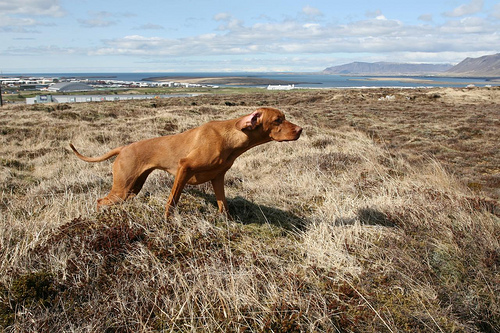

In [ ]:
#random images
#train_Set
rid = np.random.randint(0, len(img_name_train))
image = img_name_train[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_train[rid] if i not in [0]])
generate_captions(image, real_caption)
Image.open(image)

Flickr8k_Dataset/2525270674_4ab536e7ec.jpg
BELU score: 5.842838505271014
Real Caption: the brown and white dog is catching frisbee in his mouth
Prediction Caption: dog catching frisbee


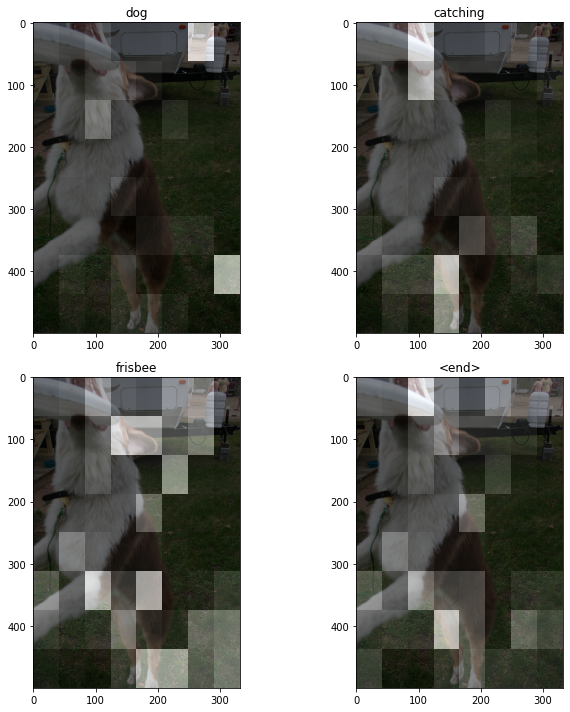

time took to Predict: 2 sec


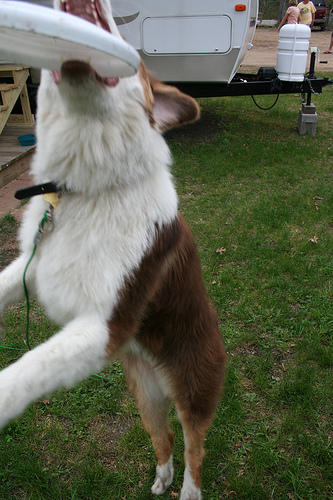

In [ ]:

#random images
#test_set
rid = np.random.randint(0, len(img_name_test))
image = img_name_test[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
generate_captions(image, real_caption)
Image.open(image)

Flickr8k_Dataset/307321761_606fc91673.jpg
BELU score: 38.503228868787126
Real Caption: group of children in uniforms stand outside
Prediction Caption: group of young men and children are standing in the road surrounded by trees


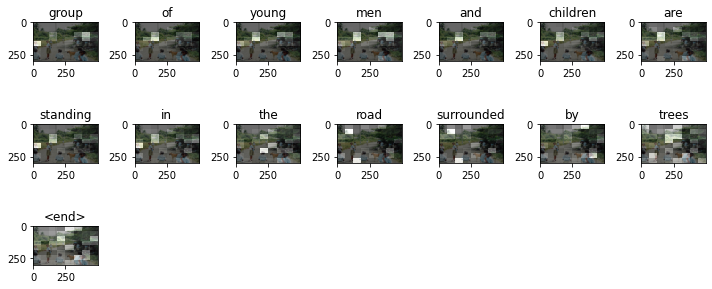

time took to Predict: 3 sec


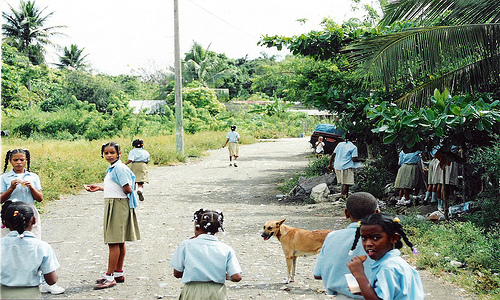

In [ ]:

#random images
#test_set
rid = np.random.randint(0, len(img_name_test))
image = img_name_test[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
generate_captions(image, real_caption)
Image.open(image)

Flickr8k_Dataset/3665179773_dd217416fc.jpg
BELU score: 31.654199979887586
Real Caption: two teenage girls hugging one wearing bicycle helmet with cyclists in the background
Prediction Caption: two girls hugging each other and smiling while holding camera


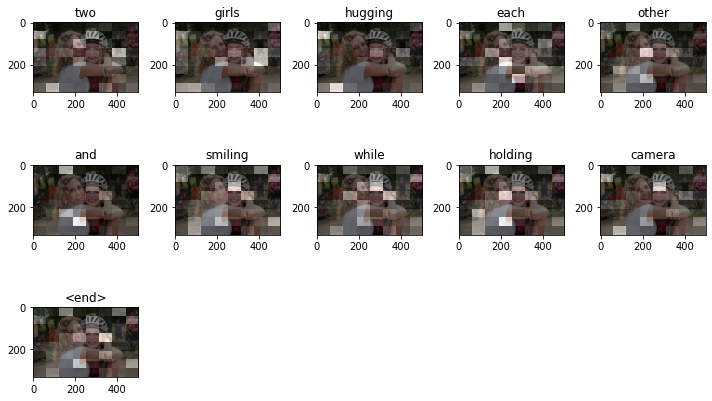

time took to Predict: 3 sec


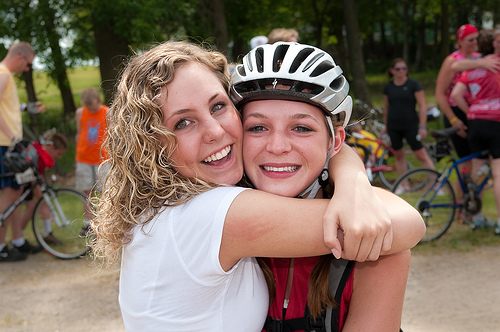

In [ ]:

#random images
#test_set
rid = np.random.randint(0, len(img_name_test))
image = img_name_test[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
generate_captions(image, real_caption)
Image.open(image)

Flickr8k_Dataset/2313230479_13f87c6bf3.jpg
BELU score: 20.142070913129906
Real Caption: brown dog and white and black dog are running in grass
Prediction Caption: two dogs play in field


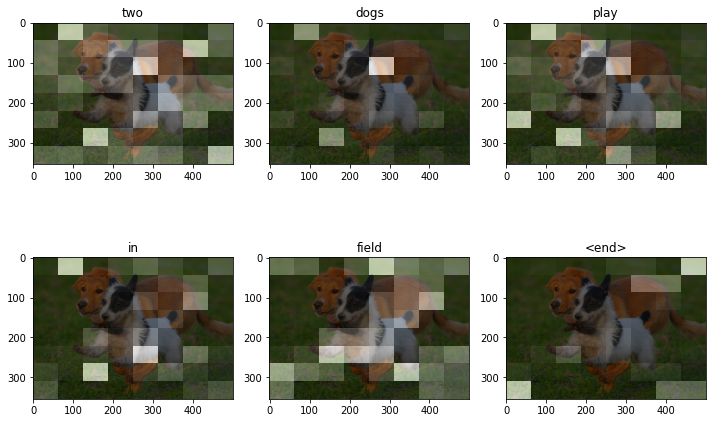

time took to Predict: 2 sec


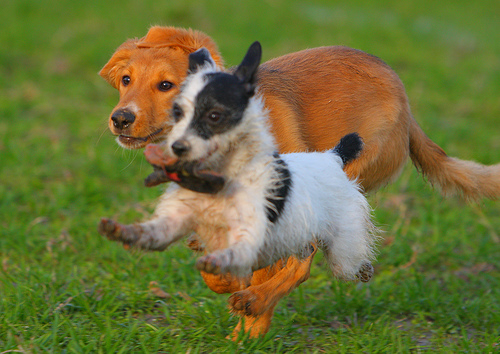

In [ ]:

#random images
#test_set
rid = np.random.randint(0, len(img_name_test))
image = img_name_test[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
generate_captions(image, real_caption)
Image.open(image)

Beam search (Beam Index = 3) ->  black dogs in through the grass
Beam search (Beam Index = 7) ->  two dogs in grass
Beam search (Beam Index = 10) ->  two dogs in grass


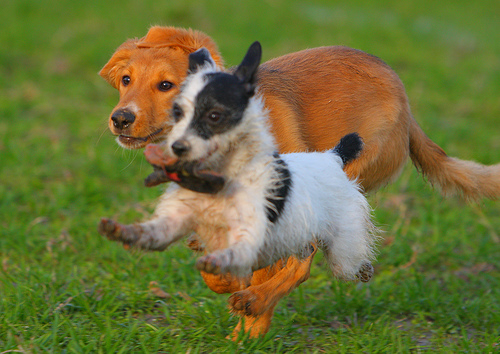

In [ ]:
image='Flickr8k_Dataset/2313230479_13f87c6bf3.jpg'

result, attention_plot = beam_search(image)
print("Beam search (Beam Index = 3) -> ", result)


result, attention_plot = beam_search(image,7)
print("Beam search (Beam Index = 7) -> ", result)

result, attention_plot = beam_search(image,10)
print("Beam search (Beam Index = 10) -> ", result)

Image.open(image)

- Flickr8k_Dataset/2942133798_e57c862a90.jpg
- BELU score: 35.73381727496467
- Real Caption: brown and white dog is running with yellow frisbee
- Prediction Caption: two dogs play with frisbee


---

- Flickr8k_Dataset/2561319255_ce5ede291e.jpg
- BELU score: 33.02232277439296
- Real Caption: young barefooted girl leaps in the air while playing toy guitar
- Prediction Caption: girl with guitar with his arms

---

- Flickr8k_Dataset/3398788809_25c71ba018.jpg
- BELU score: 25.751305773417382
- Real Caption: group of six men stand in circle playing instruments in wooded parking lot
- Prediction Caption: group of people are standing in the woods

---

- Flickr8k_Dataset/3277162496_dff7eeb59e.jpg
- BELU score: 66.8740304976422
- Real Caption: three dogs playing on grass
- Prediction Caption: two dogs play together outside

---

- Flickr8k_Dataset/3431101934_99a6c55914.jpg
- BELU score: 60.94445482670285
- Real Caption: two little girls on trampoline and playhouse is behind them
- Prediction Caption: two children are jumping on an outdoor trampoline

---

- Flickr8k_Dataset/689776124_07f560a920.jpg
- BELU score: 24.948784842401782
- Real Caption: dark dog with its tongue hanging out runs through the grass
- Prediction Caption: black dog is running through the grass

---

Real Caption:  <start> boy soccer player running down the field <end>
Beam search (Beam Index = 3) ->  two young girl in red uniform is soccer ball
Beam search (Beam Index = 7) ->  two young girl in red uniform kicking soccer ball
Beam search (Beam Index = 10) ->  little young boy in red uniform kicking soccer ball


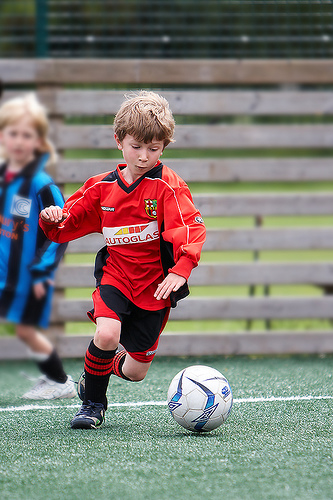

In [ ]:
rid = np.random.randint(0, len(img_name_test))
image = img_name_test[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
print("Real Caption: ",real_caption)

result, attention_plot = beam_search(image)
print("Beam search (Beam Index = 3) -> ", result)


result, attention_plot = beam_search(image,7)
print("Beam search (Beam Index = 7) -> ", result)

result, attention_plot = beam_search(image,10)
print("Beam search (Beam Index = 10) -> ", result)


Image.open(image)

In [ ]:
def bleu_score(real_caption, result_final ):
  real_appn = []
  real_appn.append(real_caption.split())
  reference = real_appn
  candidate = result_final.split()

  score = sentence_bleu(reference, candidate)
  print(f"BELU score: {score*100}")


Real Caption:  brown dog leaps through field
Greedy search ->  dog chases disc in the air
BELU score: 63.89431042462724
Beam search (Beam Index = 3) ->  tan chases through the air
BELU score: 66.8740304976422
Beam search (Beam Index = 7) ->  dog in through field air
BELU score: 62.23329772884784
Beam search (Beam Index = 10) ->  brown leaping through field air
BELU score: 62.23329772884784


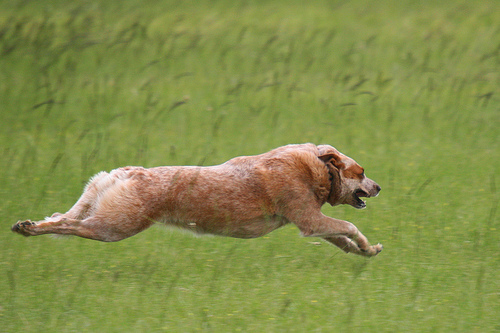

In [ ]:
rid = np.random.randint(0, len(img_name_test))
image = img_name_test[rid]

real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]
print("Real Caption: ",real_caption)

result, attention_plot = evaluate(image)
#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]
print("Greedy search -> ", result_final)
bleu_score(real_caption, result_final)

result, attention_plot = beam_search(image)
print("Beam search (Beam Index = 3) -> ", result)
bleu_score(real_caption, result)

result, attention_plot = beam_search(image,7)
print("Beam search (Beam Index = 7) -> ", result)
bleu_score(real_caption, result)

result, attention_plot = beam_search(image,10)
print("Beam search (Beam Index = 10) -> ", result)
bleu_score(real_caption, result)

Image.open(image)

Real Caption:  man sits in camping chair near the edge of rock face over body of water
Greedy search ->  man and woman fishing pole
BELU score: 9.050415858572283
Beam search (Beam Index = 3) ->  man fishing pole
BELU score: 1.3916876033168306
Beam search (Beam Index = 7) ->  man fishing pole
BELU score: 1.3916876033168306
Beam search (Beam Index = 10) ->  man fishing pole
BELU score: 1.3916876033168306


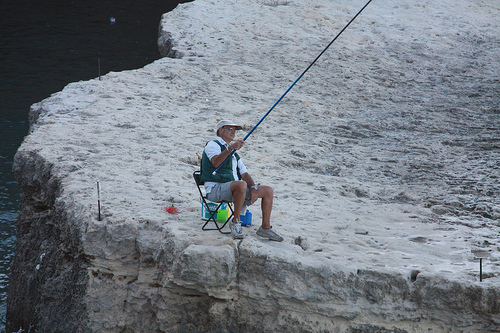

In [ ]:
rid = np.random.randint(0, len(img_name_test))
image = img_name_test[rid]

real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]
print("Real Caption: ",real_caption)

result, attention_plot = evaluate(image)
#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]
print("Greedy search -> ", result_final)
bleu_score(real_caption, result_final)

result, attention_plot = beam_search(image)
print("Beam search (Beam Index = 3) -> ", result)
bleu_score(real_caption, result)

result, attention_plot = beam_search(image,7)
print("Beam search (Beam Index = 7) -> ", result)
bleu_score(real_caption, result)

result, attention_plot = beam_search(image,10)
print("Beam search (Beam Index = 10) -> ", result)
bleu_score(real_caption, result)

Image.open(image)

Real Caption:  white bird preparing to catch something in the water
Greedy search ->  white bird reflection shows off water
BELU score: 34.1077254951379
Beam search (Beam Index = 3) ->  the bird reflection shows off water
BELU score: 51.0029457493824
Beam search (Beam Index = 7) ->  white dog reflection shows off water
BELU score: 46.08636396914616
Beam search (Beam Index = 10) ->  white dog reflection shows off water
BELU score: 46.08636396914616


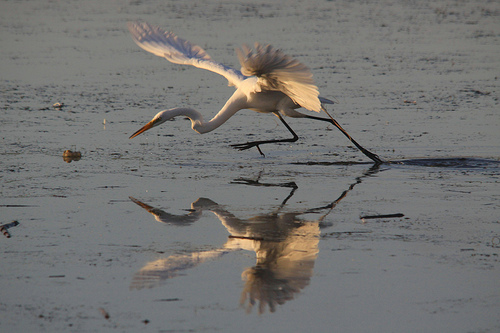

In [ ]:
rid = np.random.randint(0, len(img_name_test))
image = img_name_test[rid]

real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]
print("Real Caption: ",real_caption)

result, attention_plot = evaluate(image)
#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]
print("Greedy search -> ", result_final)
bleu_score(real_caption, result_final)

result, attention_plot = beam_search(image)
print("Beam search (Beam Index = 3) -> ", result)
bleu_score(real_caption, result)

result, attention_plot = beam_search(image,7)
print("Beam search (Beam Index = 7) -> ", result)
bleu_score(real_caption, result)

result, attention_plot = beam_search(image,10)
print("Beam search (Beam Index = 10) -> ", result)
bleu_score(real_caption, result)

Image.open(image)

Flickr8k_Dataset/3730011219_588cdc7972.jpg
Real Caption:  man and young child walk along the beach shore
Greedy search ->  man and woman looks at the beach
BELU score: 49.64505960567777
Beam search (Beam Index = 3) ->  man with child on the ocean
BELU score: 51.0029457493824
Beam search (Beam Index = 7) ->  man with child on the ocean
BELU score: 51.0029457493824
Beam search (Beam Index = 10) ->  man with child on the ocean
BELU score: 51.0029457493824


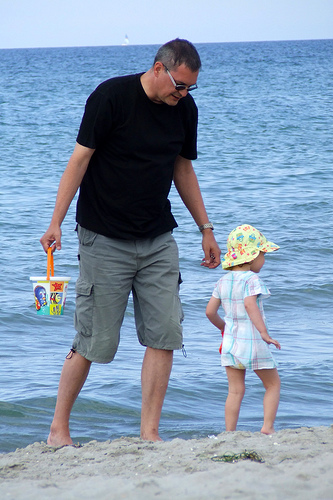

In [ ]:
rid = np.random.randint(0, len(img_name_test))
image = img_name_test[rid]
print(image)
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]
print("Real Caption: ",real_caption)

result, attention_plot = evaluate(image)
#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]
print("Greedy search -> ", result_final)
bleu_score(real_caption, result_final)

result, attention_plot = beam_search(image)
print("Beam search (Beam Index = 3) -> ", result)
bleu_score(real_caption, result)

result, attention_plot = beam_search(image,7)
print("Beam search (Beam Index = 7) -> ", result)
bleu_score(real_caption, result)

result, attention_plot = beam_search(image,10)
print("Beam search (Beam Index = 10) -> ", result)
bleu_score(real_caption, result)

Image.open(image)

['two', 'people', 'walking', 'across', 'thick', 'snow', 'at', 'dusk', '<end>']


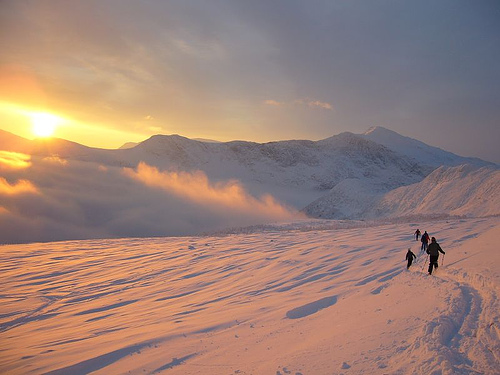

In [ ]:
# specific image
image='/content/t1.jpg'

result, attention_plot = evaluate(image)
print(result)

Image.open(image)

/content/t3.jpg
BELU score: 73.11104457090248
Real Caption: two dogs are running
Prediction Caption: two black dogs run on the sand


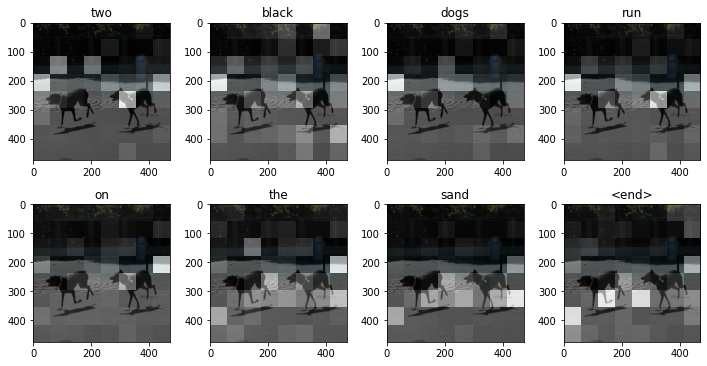

time took to Predict: 2 sec


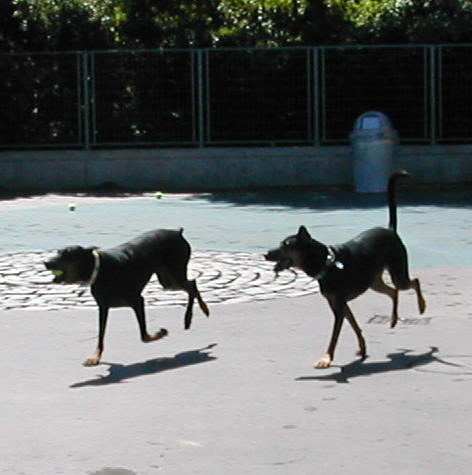

In [ ]:
# specific image
image='/content/t3.jpg'
real_caption='<start> two dogs are running <end>'

generate_captions(image,real_caption)
Image.open(image)


# Future Work

In [ ]:
cd drive/MyDrive/Flickr_8k


/content/drive/MyDrive/Flickr_8k


In [ ]:
ls

captions.pkl           features.pkl       image_captioning.py  model_19.h5
checkpoint_finally19/  Flickr8k_Dataset/  img_names.pkl        __pycache__/
descriptions.txt       Flickr8k_text/     logs/                tokenizer.pkl


In [ ]:
try:
  %tensorflow_version 2.x
except Exception:
  pass
import tensorflow as tf
print(tf.__version__)

2.7.0


In [ ]:
from image_captioning import *
from pickle import load

58900480/58889256 [==============================] - 0s 0us/step


In [ ]:
def evaluate(image, tokenizer):
        attention_plot = np.zeros((max_length, attention_features_shape))

        hidden = decoder.reset_state(batch_size=1)

        temp_input = tf.expand_dims(load_image(image)[0], 0)
        img_tensor_val = image_features_extract_model(temp_input)
        img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))

        features = encoder(img_tensor_val)

        dec_input = tf.expand_dims([tokenizer.word_index['<start>']], 0)
        result = []

        for i in range(max_length):
            predictions, hidden, attention_weights = decoder(dec_input, features, hidden)

            attention_plot[i] = tf.reshape(attention_weights, (-1, )).numpy()

            predicted_id = tf.argmax(predictions[0]).numpy()
            result.append(tokenizer.index_word[predicted_id])

            if tokenizer.index_word[predicted_id] == '<end>':
                return result, attention_plot

            dec_input = tf.expand_dims([predicted_id], 0)

        attention_plot = attention_plot[:len(result), :]
        return result, attention_plot

In [ ]:
def predict(Image_path):
    
    checkpoint_path = "/content/drive/MyDrive/Flickr_8k/checkpoint_finally19/train/ckpt-4"
    train_captions = load(open('/content/drive/MyDrive/Flickr_8k/captions.pkl', 'rb'))


    # Choose the top 5000 words from the vocabulary
    top_k = 5000   
    train_seqs , tokenizer = tokenize_caption(top_k ,train_captions)

    #restoring the model
    
    ckpt = tf.train.Checkpoint(encoder=encoder,decoder=decoder,optimizer = optimizer)
    ckpt.restore(checkpoint_path)

    new_img =  Image_path
    #image_extension = Image_path[-3:]

    #image_path = tf.keras.utils.get_file('image'+image_extension,origin=Image_path)

    result, attention_plot = evaluate(new_img, tokenizer)
    for i in result:
        if i=="<unk>":
            result.remove(i)
        else:
            pass
    
    print('Prediction Caption: ', ' '.join(result).rsplit(' ', 1)[0])

    plot_attention(new_img, result, attention_plot)
    
    image_plot(new_img)
    

Prediction Caption:  white dog is running through leaves


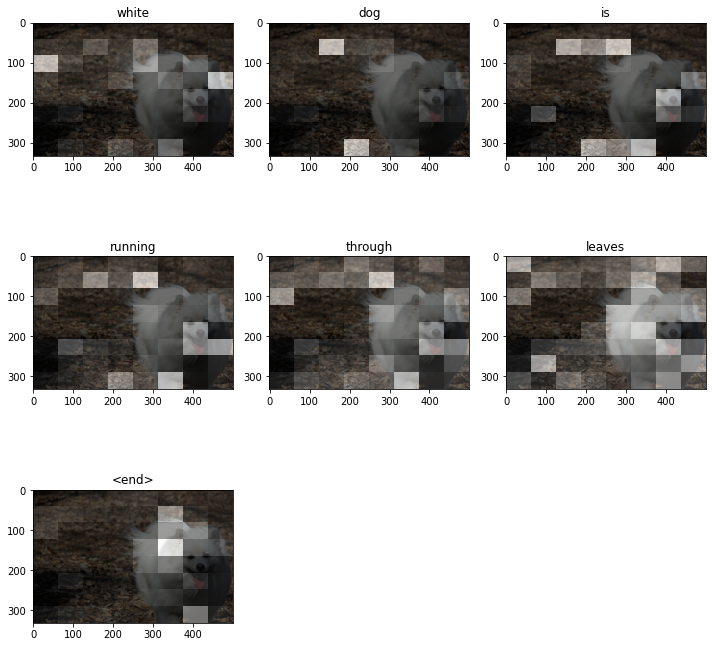

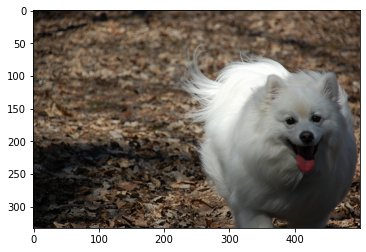

In [ ]:
predict('/content/drive/MyDrive/Flickr_8k/Flickr8k_Dataset/3439243433_d5f3508612.jpg')

Prediction Caption:  man raises his face upward and left shirt


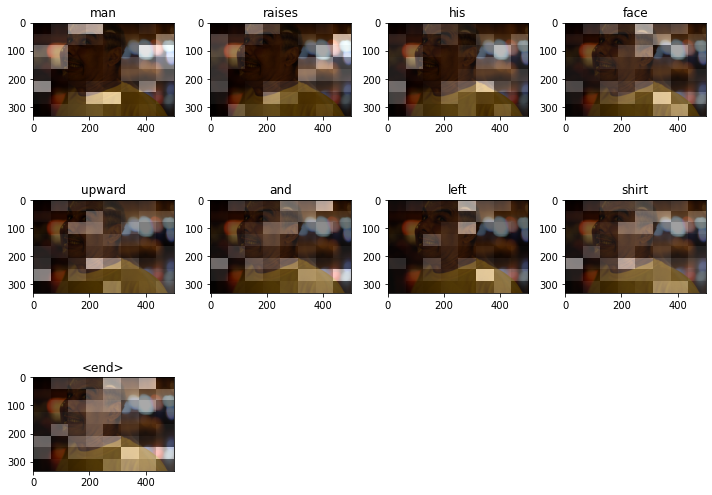

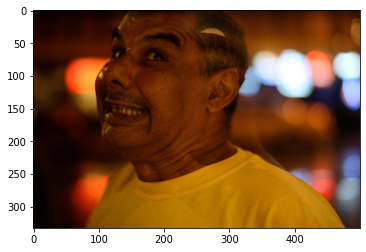

In [ ]:
predict('/content/drive/MyDrive/Flickr_8k/Flickr8k_Dataset/1167669558_87a8a467d6.jpg')

Prediction Caption:  boy with toy gun pointed at the camera


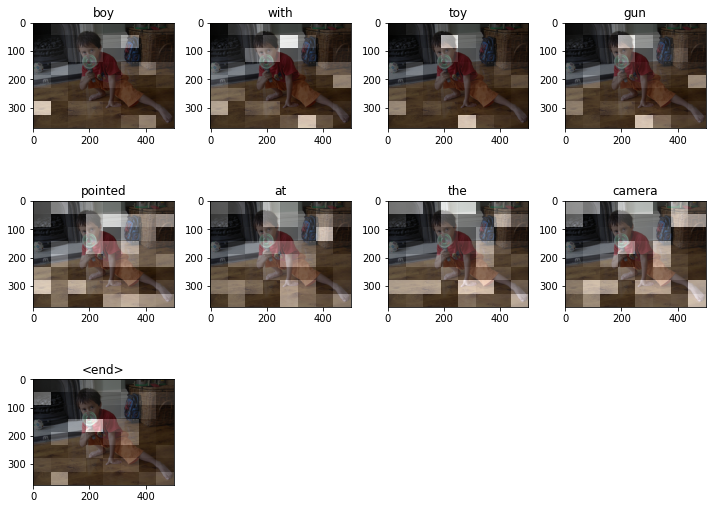

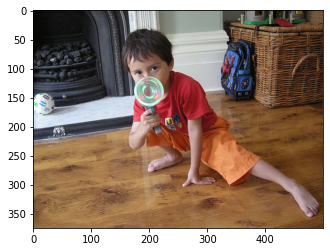

In [ ]:
predict('/content/drive/MyDrive/Flickr_8k/Flickr8k_Dataset/1096395242_fc69f0ae5a.jpg')

Prediction Caption:  two large brown dog jumps up at the camera


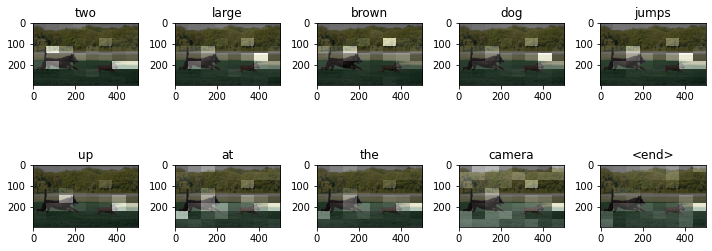

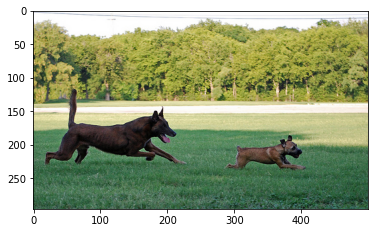

In [ ]:
predict('/content/drive/MyDrive/Flickr_8k/Flickr8k_Dataset/2723477522_d89f5ac62b.jpg')

Prediction Caption:  man in white and blue


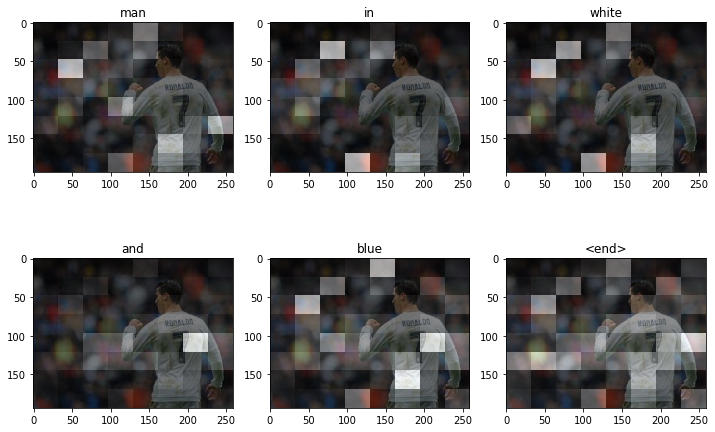

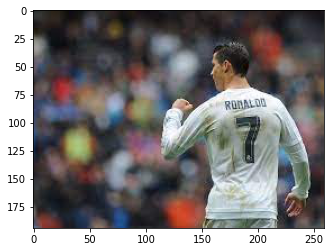

In [ ]:
predict('/content/t.jpg')

Prediction Caption:  little girl is sitting in the grass


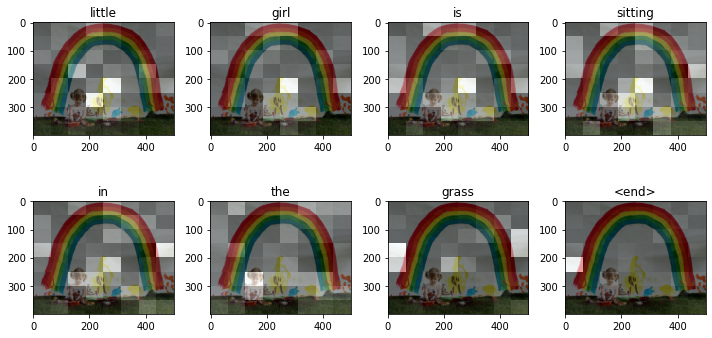

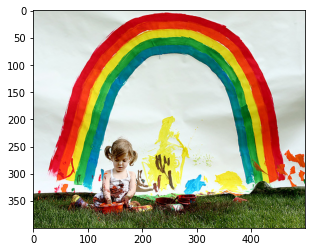

In [ ]:
predict('/content/drive/MyDrive/Flickr_8k/Flickr8k_Dataset/1002674143_1b742ab4b8.jpg')

In [ ]:
!tensorboard dev upload --logdir logs/ --name "Captionly" --description "Developed by: Sahil & Vivek"


In [ ]:
# TensorBoard live at:
https://tensorboard.dev/experiment/fvb04jIdRn6I6C16edtdEg/#scalars